In [2]:
import os
os.environ["PYTHONPATH"] = '/home/user/conda/envs/sr/lib/python3.10/site-packages'
import sys
sys.path.pop(2)
import glob
from io import BytesIO

import cv2
from PIL import Image
import pickle
from tqdm import tqdm
import json
from pathlib import Path
import numpy as np
import requests
import tempfile
import zipfile
from pathlib import Path
import matplotlib.pyplot as plt

import rasterio
import geopandas as gpd

sys.path.append('/home/jovyan/berkiu/temp/sr_detection/yolov5/')
from utils.dataloaders import autosplit
from utils.general import download, xyxy2xywhn
from utils.dataloaders import autosplit

from stable_diffusion import StableDiffusionOnnxUpscalePipeline

/home/user/conda/envs/sr/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: libtorch_cuda_cu.so: cannot open shared object file: No such file or directory
  warn(f"Failed to load image Python extension: {e}")
/home/user/conda/envs/sr/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# preparing datasets

In [70]:
def image_blur(input_directory, output_directory, sigma, scale):
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)
        
    os.chdir(input_directory)
    images = glob.glob('*.tif')
    outputs = []

    for stackclip in tqdm(images):
        OUTPUT = output_directory + stackclip.rsplit('.')[0] + '.pkl'
        outputs.append(OUTPUT)
        with rasterio.open(os.path.join(input_directory, stackclip)) as f:
            out = f.read().transpose(1,2,0)

        if sigma > 0:
            out = cv2.GaussianBlur(out, (0, 0), sigma)
            out = cv2.resize(out, (int(out.shape[1] / scale), int(out.shape[0] / scale)), interpolation=cv2.INTER_AREA)
        else:
            out = cv2.resize(out, (int(out.shape[1] / scale), int(out.shape[0] / scale)), interpolation=cv2.INTER_AREA)

        out = out.transpose(2,0,1)
        with open(OUTPUT, 'wb') as f:
            pickle.dump(out, f)
            
    print("Done")
    return outputs

In [71]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_60_images/'
outputs = image_blur(input_directory, output_directory, 1, 2)

100%|██████████| 281/281 [01:25<00:00,  3.29it/s]

Done


In [72]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_120_images/'
outputs = image_blur(input_directory, output_directory, 2, 4)

100%|██████████| 281/281 [01:08<00:00,  4.12it/s]

Done


In [73]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_240_images/'
outputs = image_blur(input_directory, output_directory, 4, 8)

100%|██████████| 281/281 [01:11<00:00,  3.95it/s]

Done


In [74]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/val_480_images/'
outputs = image_blur(input_directory, output_directory, 8, 16)

100%|██████████| 281/281 [01:27<00:00,  3.22it/s]

Done


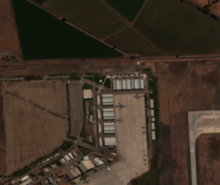

In [75]:
with open(outputs[0], 'rb') as f:
    image = pickle.load(f)
    
Image.fromarray(image.transpose(1,2,0))

In [76]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_60_images/'
outputs = image_blur(input_directory, output_directory, 1, 2)

100%|██████████| 846/846 [04:53<00:00,  2.88it/s]

Done


In [77]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_120_images/'
outputs = image_blur(input_directory, output_directory, 2, 4)

100%|██████████| 846/846 [03:22<00:00,  4.17it/s]

Done


In [78]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_240_images/'
outputs = image_blur(input_directory, output_directory, 4, 8)

100%|██████████| 846/846 [03:30<00:00,  4.02it/s]

Done


In [79]:
input_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_images/'
output_directory = '/home/jovyan/berkiu/temp/sr_detection/data/train_480_images/'
outputs = image_blur(input_directory, output_directory, 8, 16)

100%|██████████| 846/846 [04:09<00:00,  3.39it/s]

Done


In [81]:
outputs[0]

'/home/jovyan/berkiu/temp/sr_detection/data/train_480_images/2399.pkl'

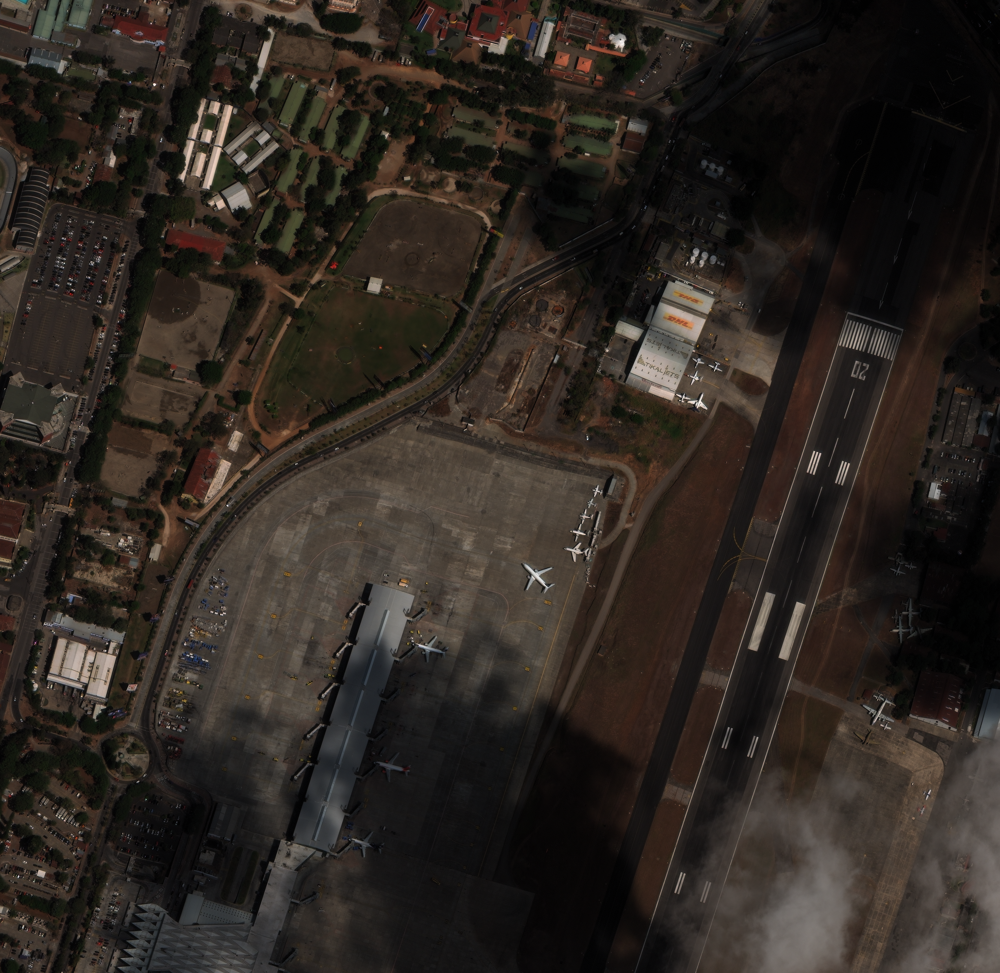

In [82]:
i = rasterio.open('/home/jovyan/berkiu/temp/sr_detection/data/train_images/2399.tif').read()
Image.fromarray(i.transpose(1,2,0))

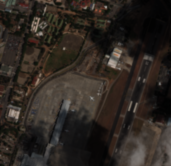

In [80]:
with open(outputs[0], 'rb') as f:
    image = pickle.load(f)
    
Image.fromarray(image.transpose(1,2,0))

# preparing data as in article

In [53]:
data = gpd.read_file('./data/xView_train.geojson')

In [63]:
data.head(3)

,bounds_imcoords,edited_by,cat_id,type_id,ingest_time,index_right,image_id,point_geom,feature_id,grid_file,geometry
0,"2712,1145,2746,1177",wwoscarbecerril,1040010028371A00,73,2017-07-24T12:49:09.118000+00:00,2356,2355.tif,0101000020E6100000616E4E6406A256C03BE6ADA0D621...,374410,Grid2.shp,"POLYGON ((-90.53170 14.56604, -90.53170 14.566..."
1,"2720,2233,2760,2288",wwoscarbecerril,1040010028371A00,73,2017-07-24T17:26:05.701000+00:00,2356,2355.tif,0101000020E6100000042D0CC705A256C0004F7071E71F...,394393,Grid2.shp,"POLYGON ((-90.53167 14.56222, -90.53167 14.562..."
2,"2687,1338,2740,1399",wwoscarbecerril,1040010028371A00,73,2017-07-24T12:45:09.081000+00:00,2356,2355.tif,0101000020E6100000B29F7E4707A256C0000AE6537921...,374031,Grid2.shp,"POLYGON ((-90.53179 14.56527, -90.53179 14.565..."


In [61]:
np.unique(data.type_id)

array([11, 12, 13, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 32,
       33, 34, 35, 36, 37, 38, 40, 41, 42, 44, 45, 47, 49, 50, 51, 52, 53,
       54, 55, 56, 57, 59, 60, 61, 62, 63, 64, 65, 66, 71, 72, 73, 74, 75,
       76, 77, 79, 82, 83, 84, 86, 89, 91, 93, 94])

In [51]:
len(data)

601937

In [52]:
article_categories = [11, 12, 13, 17, 18, 20, 21, 19, 23, 24, 25, 28,
                      29, 60, 61, 65, 26, 41, 42, 50, 40, 44, 45, 47]

In [62]:
article_data = data.loc[data['type_id'].isin(article_categories)]
article_data.head(3)

,bounds_imcoords,edited_by,cat_id,type_id,ingest_time,index_right,image_id,point_geom,feature_id,grid_file,geometry
40,"2726,2512,2740,2518",wwkarlanicole,1040010028371A00,18,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E610000050DC892506A256C07C8F3AE3741F...,75689,Grid2.shp,"POLYGON ((-90.53165 14.56143, -90.53165 14.561..."
41,"2729,2494,2737,2504",wwkarlanicole,1040010028371A00,18,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E61000002A7BE02B06A256C0DA641EFB7B1F...,75691,Grid2.shp,"POLYGON ((-90.53164 14.56148, -90.53164 14.561..."
42,"2726,2501,2737,2513",wwkarlanicole,1040010028371A00,18,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E6100000B257E43E06A256C02B7CB687781F...,75690,Grid2.shp,"POLYGON ((-90.53165 14.56145, -90.53165 14.561..."


In [64]:
len(article_data)

257650

In [69]:
# as in the article, we should unite some categories in supercategories, f.e. 
# Small Aircraft (Fixed-wing Aircraft, Small Aircraft),
# Large Aircraft (Cargo Plane), 
# Small Vehicle (Passenger Vehicle, Small Car, Pickup Truck, Utility Truck),
# Bus/Truck (Bus, Truck, Cargo Truck, Truck w/Box, Truck w/Flatbed, Truck w/Liquid, Dump Truck, Haul Truck, Cement Mixer, Truck Tractor),
# Boat (Motorboat, Sailboat, Yacht, Maritime Vessel, Tugboat, Barge, Fishing Vessel, Ferry)

super_categories = {1: [11, 12], 2: [13], 3: [17, 18, 20, 21],
                    4: [19, 23, 24, 25, 28, 29, 60, 61, 65, 26],
                    5: [41, 42, 50, 40, 44, 45, 47, 49]}

# where 1 is Small Aircraft
# 2 is Large Aircraft
# 3 is Small Vehicle
# 4 is Bus/Truck
# 5 is Boat

cat_to_super = {v_: k for k, v in super_categories.items() for v_ in v}

In [71]:
super_data = article_data.copy()
new_type_id = [cat_to_super[x] for x in article_data['type_id']]
super_data['type_id'] = new_type_id
super_data.head(3)

,bounds_imcoords,edited_by,cat_id,type_id,ingest_time,index_right,image_id,point_geom,feature_id,grid_file,geometry
40,"2726,2512,2740,2518",wwkarlanicole,1040010028371A00,3,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E610000050DC892506A256C07C8F3AE3741F...,75689,Grid2.shp,"POLYGON ((-90.53165 14.56143, -90.53165 14.561..."
41,"2729,2494,2737,2504",wwkarlanicole,1040010028371A00,3,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E61000002A7BE02B06A256C0DA641EFB7B1F...,75691,Grid2.shp,"POLYGON ((-90.53164 14.56148, -90.53164 14.561..."
42,"2726,2501,2737,2513",wwkarlanicole,1040010028371A00,3,2017-07-06T15:40:23.038000+00:00,2356,2355.tif,0101000020E6100000B257E43E06A256C02B7CB687781F...,75690,Grid2.shp,"POLYGON ((-90.53165 14.56145, -90.53165 14.561..."


# some stats per super categories

<BarContainer object of 5 artists>

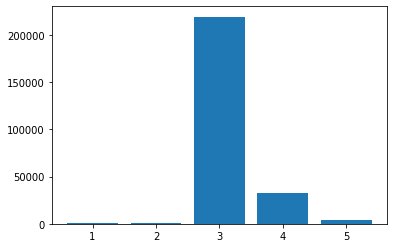

In [77]:
plt.bar(np.unique(super_data['type_id']), np.bincount(super_data['type_id'])[1:])

In [76]:
np.bincount(super_data['type_id'])[1:]

array([   442,    718, 219360,  32607,   4523])

# SD

In [ ]:
!python /home/jovyan/berkiu/temp/sr_detection/convert_stable_diffusion_checkpoint_to_onnx.py --model_path stabilityai/stable-diffusion-x4-upscaler --output_path ./sd

In [4]:
tmp_models_file = './sd_v1.0.0.zip'
with tempfile.TemporaryDirectory() as tmp_dir:
    with zipfile.ZipFile(tmp_models_file, 'r') as zip_ref:
        zip_ref.extractall(tmp_dir)
    pipe = StableDiffusionOnnxUpscalePipeline.from_pretrained(Path(tmp_dir), provider='CUDAExecutionProvider')

2023-06-06 19:13:46.566237274 [W:onnxruntime:, session_state.cc:1030 VerifyEachNodeIsAssignedToAnEp] Some nodes were not assigned to the preferred execution providers which may or may not have an negative impact on performance. e.g. ORT explicitly assigns shape related ops to CPU to improve perf.
2023-06-06 19:13:46.566295805 [W:onnxruntime:, session_state.cc:1032 VerifyEachNodeIsAssignedToAnEp] Rerunning with verbose output on a non-minimal build will show node assignments.
2023-06-06 19:13:54.784514355 [W:onnxruntime:, session_state.cc:1030 VerifyEachNodeIsAssignedToAnEp] Some nodes were not assigned to the preferred execution providers which may or may not have an negative impact on performance. e.g. ORT explicitly assigns shape related ops to CPU to improve perf.
2023-06-06 19:13:54.784563017 [W:onnxruntime:, session_state.cc:1032 VerifyEachNodeIsAssignedToAnEp] Rerunning with verbose output on a non-minimal build will show node assignments.


In [11]:
url = "https://huggingface.co/datasets/hf-internal-testing/diffusers-images/resolve/main/sd2-upscale/low_res_cat.png"
response = requests.get(url)
low_res_img = Image.open(BytesIO(response.content)).convert("RGB")
low_res_img = low_res_img.resize((512, 512))

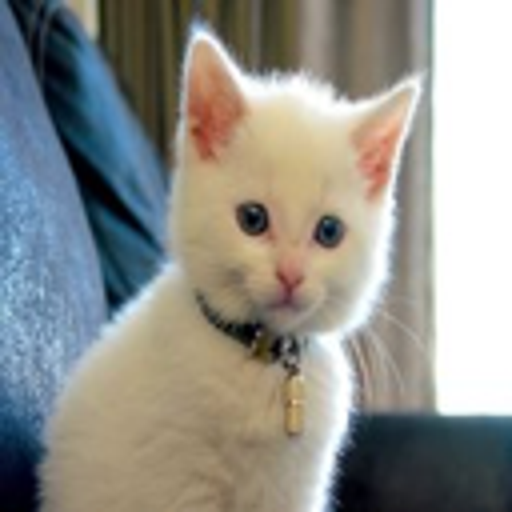

In [12]:
low_res_img

100%|██████████| 50/50 [00:20<00:00,  2.40it/s]


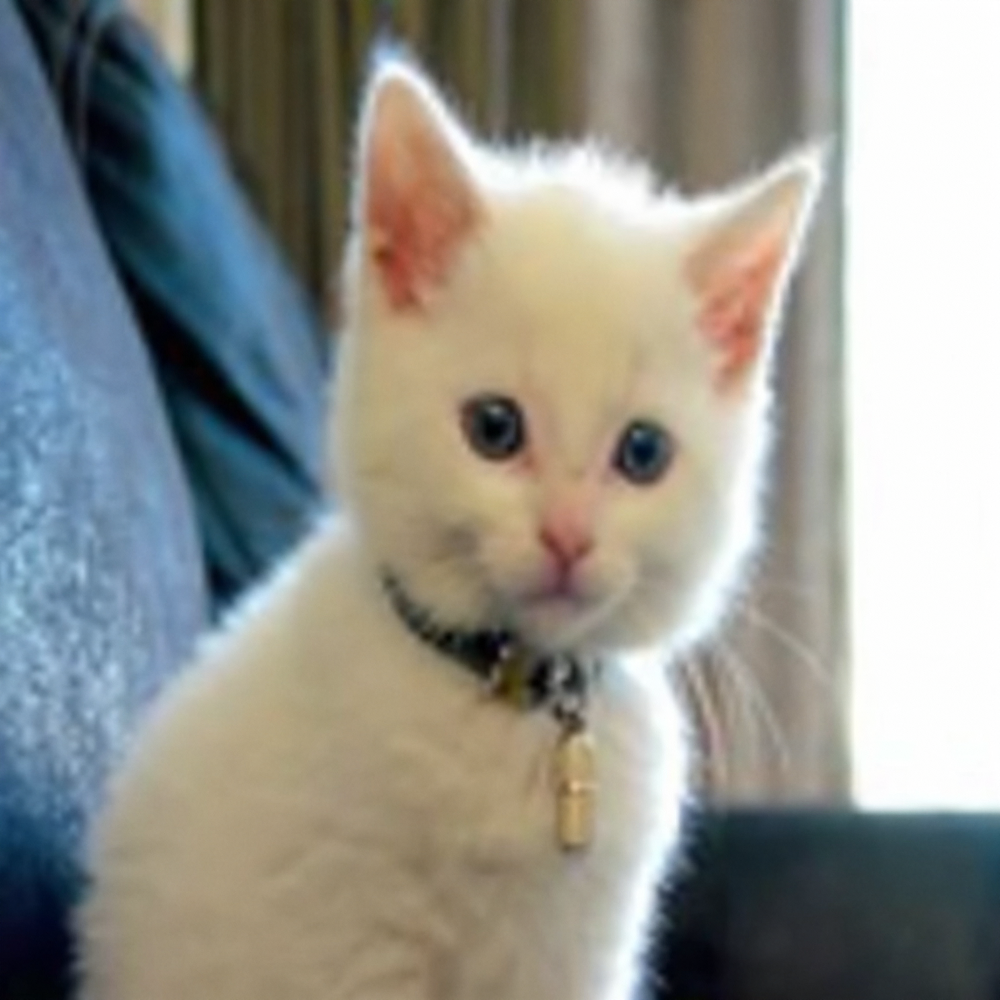

In [13]:
import requests
from PIL import Image
from io import BytesIO
from diffusers import StableDiffusionUpscalePipeline
import torch

# load model and scheduler
model_id = "stabilityai/stable-diffusion-x4-upscaler"
pipeline = StableDiffusionUpscalePipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipeline = pipeline.to("cuda")
pipeline.enable_attention_slicing()
#pipeline.set_use_memory_efficient_attention_xformers(True)

upscaled_image = pipeline(prompt='', image=low_res_img, num_inference_steps=50).images[0]
upscaled_image

In [55]:
# 240 -> 60 cm

train_root = 'datasets/xView/images/train/'
train_240_root = 'datasets/xView/train_240_images/'
train_tiffs = os.listdir('datasets/xView/images/train/')
train_60_sr_root = 'datasets/xView/train_60_sr_images/'
if not os.path.exists(train_60_sr_root):
    os.makedirs(train_60_sr_root)

for tiff_name in tqdm(train_tiffs):
    f = rasterio.open(os.path.join(train_root, tiff_name))
    
    profile = f.profile
    profile['width'] = int(profile['width'] / 2)
    profile['height'] = int(profile['height'] / 2)
    
    with open(os.path.join(train_240_root, tiff_name.rsplit('.')[0] + '.pkl'), 'rb') as src:
        image = pickle.load(src)
        
    image_ = cv2.resize(image.transpose(1,2,0), (512,512))
    image_ = Image.fromarray(image_)
        
    out = pipeline(prompt='', image=image_, num_inference_steps=50).images[0]
    
    out_ = cv2.resize(np.array(out), (profile['width'], profile['height'])).transpose(2,0,1)
    
    with rasterio.open(os.path.join(train_60_sr_root, tiff_name), 'w', **profile) as src:
        src.write(out_)

 18%|█▊        | 9/50 [00:03<00:17,  2.40it/s]


 38%|███▊      | 19/50 [00:08<00:13,  2.38it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.39it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.40it/s]


 98%|█████████▊| 49/50 [00:20<00:00,  2.39it/s]


 14%|█▍        | 7/50 [00:02<00:17,  2.40it/s]


 34%|███▍      | 17/50 [00:07<00:13,  2.40it/s]


 54%|█████▍    | 27/50 [00:11<00:09,  2.40it/s]


 74%|███████▍  | 37/50 [00:15<00:05,  2.39it/s]


 94%|█████████▍| 47/50 [00:19<00:01,  2.38it/s]


 10%|█         | 5/50 [00:02<00:18,  2.40it/s]


 30%|███       | 15/50 [00:06<00:14,  2.39it/s]


 50%|█████     | 25/50 [00:10<00:10,  2.39it/s]


 70%|███████   | 35/50 [00:14<00:06,  2.39it/s]


 90%|█████████ | 45/50 [00:18<00:02,  2.39it/s]


  6%|▌         | 3/50 [00:01<00:19,  2.40it/s]


 26%|██▌       | 13/50 [00:05<00:15,  2.40it/s]


 46%|████▌     | 23/50 [00:09<00:11,  2.39it/s]


 66%|██████▌   | 33/50 [00:13<00:07,  2.39it/s]


 86%|████████▌ | 43/50 [00:17<00:02,  2.39it/s]


  2%|▏         | 1/50 [00:00<00:20,  2.40it/s]


 22%|██▏       | 11/50 [00:04<00:16,  2.39it/s]


 42%|████▏     | 21/50 [00:08<00:12,  2.40it/s]


 62%|██████▏   | 31/50 [00:12<00:07,  2.40it/s]


 82%|████████▏ | 41/50 [00:17<00:03,  2.39it/s]


 19%|█▉        | 161/846 [1:21:14<5:45:01, 30.22s/it]


 18%|█▊        | 9/50 [00:03<00:17,  2.39it/s]


 38%|███▊      | 19/50 [00:07<00:12,  2.39it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.40it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.39it/s]


100%|██████████| 50/50 [00:20<00:00,  2.40it/s]

 86%|████████▌ | 43/50 [00:18<00:02,  2.39it/s]


  2%|▏         | 1/50 [00:00<00:20,  2.41it/s]


 22%|██▏       | 11/50 [00:04<00:16,  2.39it/s]


 42%|████▏     | 21/50 [00:08<00:12,  2.39it/s]


 62%|██████▏   | 31/50 [00:12<00:07,  2.40it/s]


 82%|████████▏ | 41/50 [00:17<00:03,  2.39it/s]


 28%|██▊       | 233/846 [1:57:34<5:09:13, 30.27s/it]


 18%|█▊        | 9/50 [00:03<00:17,  2.39it/s]


 38%|███▊      | 19/50 [00:07<00:12,  2.39it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.39it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.39it/s]


 98%|█████████▊| 49/50 [00:20<00:00,  2.39it/s]


 14%|█▍        | 7/50 [00:02<00:18,  2.39it/s]


 34%|███▍      | 17/50 [00:07<00:13,  2.40it/s]


 54%|█████▍    | 27/50 [00:11<00:10,  2.20it/s]


 74%|███████▍  | 37/50 [00:15<00:05,  2.40it/s]


 94%|█████████▍| 47/50 [00:19<00:01,  2.39it/s]


 10%|█         | 5/50 [00:02<00:18,  2.40it/s]


 30%|███       | 15/50 [00:06<00:14,  2.40it/s]


 50%|█████     | 25/50 [00:10<00:10,  2.39it/s]


 70%|███████   | 35/50 [00:14<00:06,  2.39it/s]


 90%|█████████ | 45/50 [00:18<00:02,  2.39it/s]


  6%|▌         | 3/50 [00:01<00:19,  2.40it/s]


 26%|██▌       | 13/50 [00:05<00:15,  2.40it/s]


 46%|████▌     | 23/50 [00:09<00:11,  2.40it/s]


 66%|██████▌   | 33/50 [00:13<00:07,  2.39it/s]


 86%|████████▌ | 43/50 [00:17<00:02,  2.38it/s]


  2%|▏         | 1/50 [00:00<00:20,  2.40it/s]


 22%|██▏       | 11/50 [00:04<00:16,  2.39it/s]


 42%|████▏     | 21/50 [00:08<00:12,  2.40it/s]


 62%|██████▏   | 31/50 [00:12<00:07,  2.40it/s]


 82%|████████▏ | 41/50 [00:17<00:03,  2.40it/s]


 47%|████▋     | 394/846 [3:18:46<3:47:49, 30.24s/it]


 18%|█▊        | 9/50 [00:03<00:17,  2.40it/s]


 38%|███▊      | 19/50 [00:08<00:13,  2.35it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.40it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.39it/s]


 98%|█████████▊| 49/50 [00:20<00:00,  2.39it/s]


 14%|█▍        | 7/50 [00:02<00:17,  2.40it/s]


 34%|███▍      | 17/50 [00:07<00:13,  2.40it/s]


 54%|█████▍    | 27/50 [00:11<00:09,  2.40it/s]


 74%|███████▍  | 37/50 [00:15<00:05,  2.24it/s]


 94%|█████████▍| 47/50 [00:19<00:01,  2.39it/s]


 10%|█         | 5/50 [00:02<00:18,  2.40it/s]


 30%|███       | 15/50 [00:06<00:14,  2.40it/s]


 50%|█████     | 25/50 [00:10<00:10,  2.39it/s]


 70%|███████   | 35/50 [00:14<00:06,  2.40it/s]


 90%|█████████ | 45/50 [00:18<00:02,  2.39it/s]


  6%|▌         | 3/50 [00:01<00:19,  2.40it/s]


 26%|██▌       | 13/50 [00:05<00:15,  2.39it/s]


 46%|████▌     | 23/50 [00:09<00:11,  2.39it/s]


 66%|██████▌   | 33/50 [00:13<00:07,  2.39it/s]


 86%|████████▌ | 43/50 [00:18<00:02,  2.39it/s]


  2%|▏         | 1/50 [00:00<00:20,  2.41it/s]


 22%|██▏       | 11/50 [00:04<00:16,  2.40it/s]


 42%|████▏     | 21/50 [00:08<00:12,  2.40it/s]


 62%|██████▏   | 31/50 [00:12<00:07,  2.39it/s]


 82%|████████▏ | 41/50 [00:17<00:03,  2.37it/s]


 66%|██████▌   | 555/846 [4:39:58<2:26:39, 30.24s/it]


 18%|█▊        | 9/50 [00:03<00:17,  2.40it/s]


 38%|███▊      | 19/50 [00:07<00:12,  2.40it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.40it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.40it/s]


 98%|█████████▊| 49/50 [00:20<00:00,  2.40it/s]


 14%|█▍        | 7/50 [00:03<00:18,  2.33it/s]


 34%|███▍      | 17/50 [00:07<00:13,  2.39it/s]


 54%|█████▍    | 27/50 [00:11<00:09,  2.39it/s]


 74%|███████▍  | 37/50 [00:15<00:05,  2.39it/s]


 94%|█████████▍| 47/50 [00:19<00:01,  2.39it/s]


 10%|█         | 5/50 [00:02<00:18,  2.40it/s]


 30%|███       | 15/50 [00:06<00:14,  2.40it/s]


 50%|█████     | 25/50 [00:10<00:10,  2.40it/s]


 70%|███████   | 35/50 [00:14<00:06,  2.39it/s]


 90%|█████████ | 45/50 [00:18<00:02,  2.31it/s]


  6%|▌         | 3/50 [00:01<00:19,  2.40it/s]


 26%|██▌       | 13/50 [00:05<00:15,  2.39it/s]


 46%|████▌     | 23/50 [00:09<00:11,  2.38it/s]


 66%|██████▌   | 33/50 [00:13<00:07,  2.39it/s]


 86%|████████▌ | 43/50 [00:17<00:02,  2.40it/s]


  2%|▏         | 1/50 [00:00<00:20,  2.41it/s]


 22%|██▏       | 11/50 [00:04<00:16,  2.35it/s]


 42%|████▏     | 21/50 [00:08<00:12,  2.39it/s]


 62%|██████▏   | 31/50 [00:13<00:08,  2.25it/s]


 82%|████████▏ | 41/50 [00:17<00:03,  2.39it/s]


 85%|████████▍ | 716/846 [6:01:13<1:05:37, 30.29s/it]


 18%|█▊        | 9/50 [00:03<00:17,  2.40it/s]


 38%|███▊      | 19/50 [00:07<00:12,  2.39it/s]


 58%|█████▊    | 29/50 [00:12<00:08,  2.39it/s]


 78%|███████▊  | 39/50 [00:16<00:04,  2.40it/s]


 98%|█████████▊| 49/50 [00:20<00:00,  2.40it/s]


 14%|█▍        | 7/50 [00:02<00:17,  2.40it/s]


 34%|███▍      | 17/50 [00:07<00:13,  2.39it/s]


 54%|█████▍    | 27/50 [00:11<00:09,  2.40it/s]


 74%|███████▍  | 37/50 [00:15<00:05,  2.39it/s]


 94%|█████████▍| 47/50 [00:19<00:01,  2.40it/s]


 10%|█         | 5/50 [00:02<00:18,  2.40it/s]


 30%|███       | 15/50 [00:06<00:14,  2.40it/s]


 50%|█████     | 25/50 [00:10<00:10,  2.40it/s]


 70%|███████   | 35/50 [00:14<00:06,  2.39it/s]


 90%|█████████ | 45/50 [00:18<00:02,  2.40it/s]


  6%|▌         | 3/50 [00:01<00:19,  2.40it/s]


 26%|██▌       | 13/50 [00:05<00:15,  2.40it/s]


 46%|████▌     | 23/50 [00:09<00:11,  2.40it/s]


 66%|██████▌   | 33/50 [00:13<00:07,  2.39it/s]


 86%|████████▌ | 43/50 [00:18<00:02,  2.39it/s]


100%|██████████| 846/846 [7:06:47<00:00, 30.27s/it]


In [49]:
f = rasterio.open('datasets/xView/train_60_sr_images/2399.tif')

In [50]:
f.profile

{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': 0.0, 'width': 1369, 'height': 1333, 'count': 3, 'crs': CRS.from_epsg(4326), 'transform': Affine(3.4360559617571698e-06, 0.0, -90.53218477302893,
       0.0, -3.4360559617571698e-06, 14.597295869070331), 'blockysize': 2, 'tiled': False, 'interleave': 'band'}

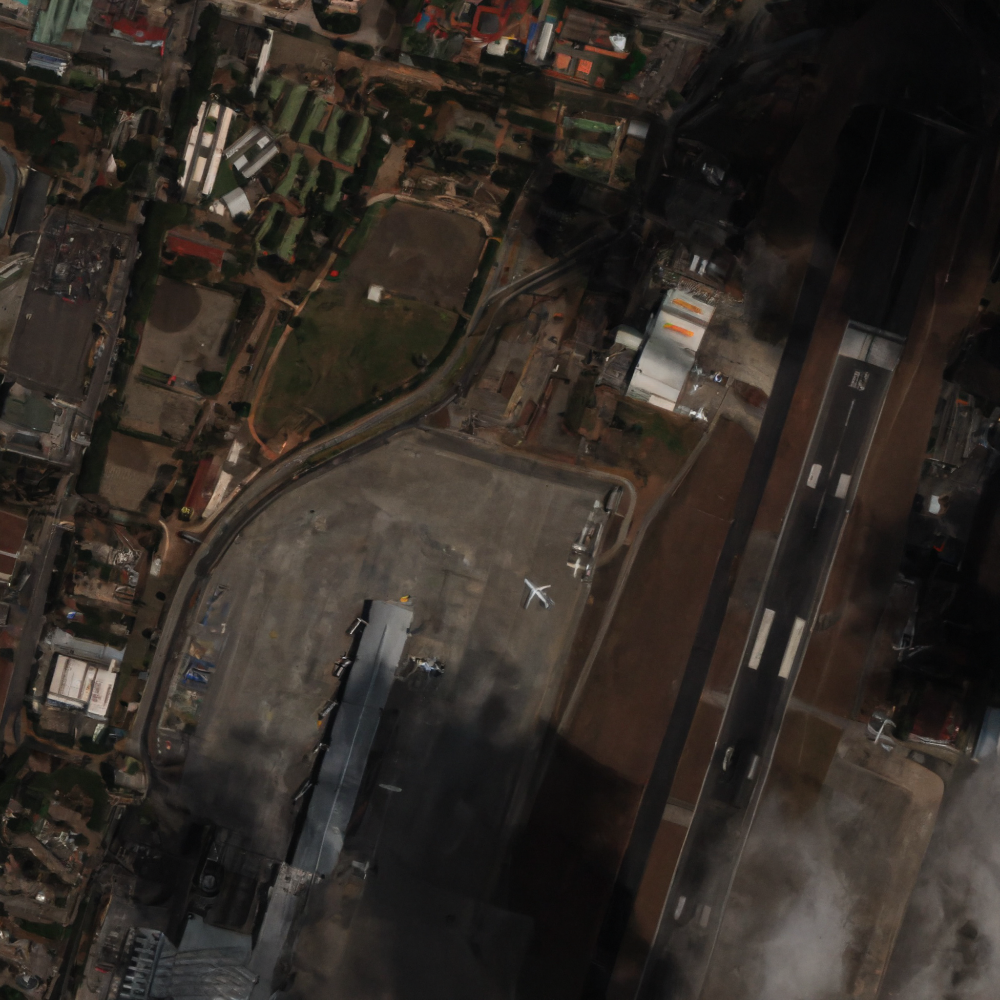

In [51]:
out

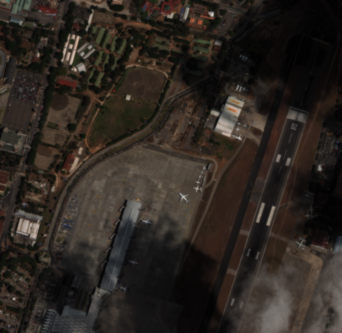

In [57]:
with open('datasets/xView/train_240_images/2399.pkl', 'rb') as src:
    i = pickle.load(src)
    
Image.fromarray(i.transpose(1,2,0))

In [58]:
i.shape

(3, 333, 342)

In [52]:
out_.shape

(3, 1333, 1369)

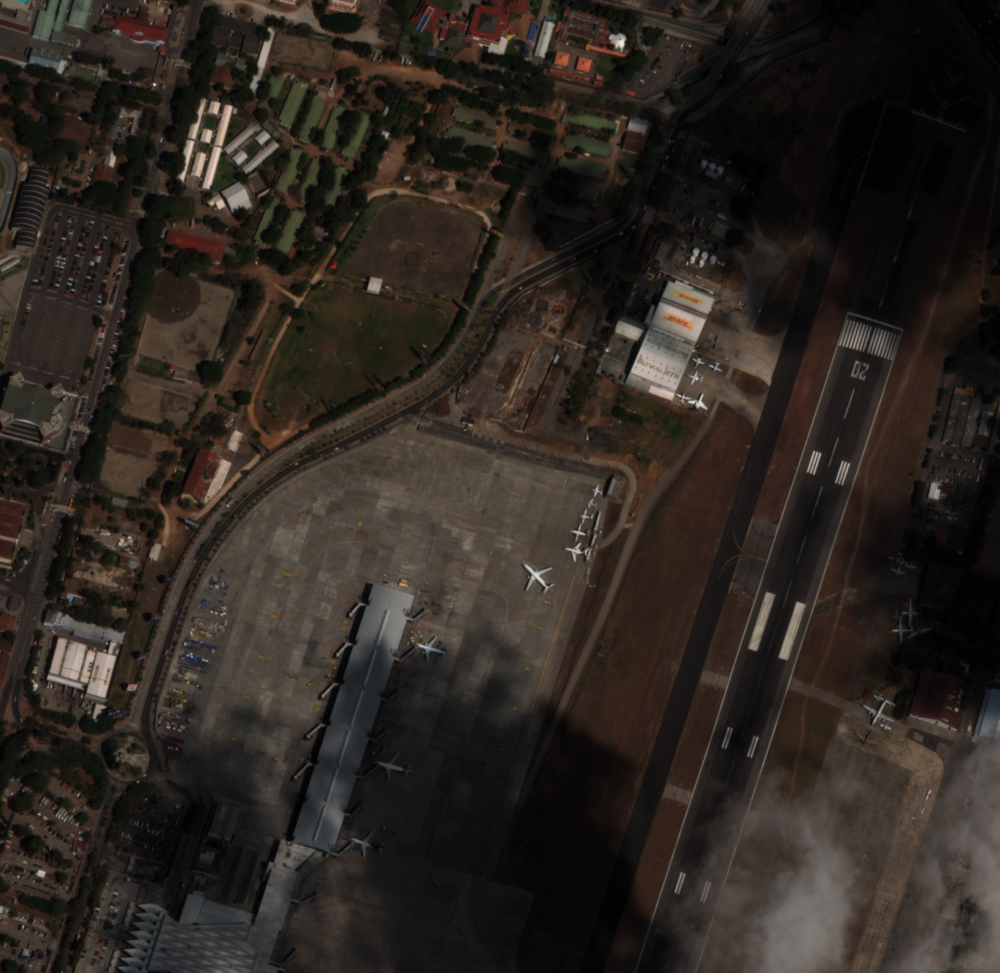

In [59]:
with open('datasets/xView/train_60_images/2399.pkl', 'rb') as src:
    i = pickle.load(src)
    
Image.fromarray(i.transpose(1,2,0))

In [60]:
i.shape

(3, 1333, 1369)

In [61]:
# converting 60 cm pkl to tiffs for yolo5 training

train_root = 'datasets/xView/images/train/'
train_60_root = 'datasets/xView/train_60_images/'
train_tiffs = os.listdir('datasets/xView/images/train/')
train_60_tiff_root = 'datasets/xView/train_60_tiff_images/'
if not os.path.exists(train_60_tiff_root):
    os.makedirs(train_60_tiff_root)

for tiff_name in tqdm(train_tiffs):
    f = rasterio.open(os.path.join(train_root, tiff_name))
    
    profile = f.profile
    profile['width'] = int(profile['width'] / 2)
    profile['height'] = int(profile['height'] / 2)
    
    with open(os.path.join(train_60_root, tiff_name.rsplit('.')[0] + '.pkl'), 'rb') as src:
        image = pickle.load(src)
    
    with rasterio.open(os.path.join(train_60_tiff_root, tiff_name), 'w', **profile) as src:
        src.write(image)

100%|██████████| 846/846 [00:48<00:00, 17.59it/s]


# Train YOLO

In [78]:
def convert_labels(fname=Path('xView/xView_train.geojson')):
    # Convert xView geoJSON labels to YOLO format
    path = fname.parent
    with open(fname) as f:
        print(f'Loading {fname}...')
        data = json.load(f)

    # Make dirs
    labels = Path(path / 'labels' / 'train')
    os.system(f'rm -rf {labels}')
    labels.mkdir(parents=True, exist_ok=True)

    # xView classes 11-94 to 0-4
    xview_class2index = [-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 0, 0, 1, -1, -1, -1, 2, 2, 3, 2, 2, -1, 3, 3, 3, 3, -1, 3, 3, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 4, 4, 4, -1, 4, -1, -1, 4, -1, 4, 4, -1, -1, -1, -1, -1, -1, -1, -1, -1, 3, 3, -1, -1, -1, 3, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]

    shapes = {}
    for feature in tqdm(data['features'], desc=f'Converting {fname}'):
        p = feature['properties']
        if p['bounds_imcoords']:
            id = p['image_id']
            file = path / 'train_images' / id
            if file.exists():  # 1395.tif missing
                try:
                    box = np.array([int(num) for num in p['bounds_imcoords'].split(",")])
                    assert box.shape[0] == 4, f'incorrect box shape {box.shape[0]}'
                    cls = p['type_id']
                    cls = xview_class2index[int(cls)]  # xView class to 0-60
                    assert 59 >= cls >= 0, f'incorrect class index {cls}'

                    # Write YOLO label
                    if id not in shapes:
                        shapes[id] = Image.open(file).size
                    box = xyxy2xywhn(box[None].astype(np.float64), w=shapes[id][0], h=shapes[id][1], clip=True)
                    with open((labels / id).with_suffix('.txt'), 'a') as f:
                        f.write(f"{cls} {' '.join(f'{x:.6f}' for x in box[0])}\n")  # write label.txt
                except Exception as e:
                    print(f'WARNING: skipping one label for {file}: {e}')

In [ ]:
convert_labels(Path('datasets/xView/xView_train.geojson'))

In [91]:
autosplit('./datasets/xView/images/train/')

Autosplitting images from datasets/xView/images/train


100%|██████████| 846/846 [00:01<00:00, 718.43it/s]


In [ ]:
!python3 train.py --data xView.yaml --epochs 150 --img 544 --optimizer AdamW --weights '' --cfg yolov5x.yaml  --batch-size 64

# PSNR/SSIM for 240 -> 60

In [62]:
from math import log10, sqrt
  
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [66]:
from skimage.metrics import structural_similarity

In [80]:
orig_60_root = 'datasets/xView/images/train/'
sd_60_root = 'datasets/xView/images/train_60_sd/'
tiffs = os.listdir(orig_60_root)

PSNRS = 0
SSIMS = 0
for tiff_name in tqdm(tiffs):
    orig = rasterio.open(os.path.join(orig_60_root, tiff_name)).read()
    sr = rasterio.open(os.path.join(sd_60_root, tiff_name)).read()
    
    PSNRS += PSNR(orig, sr)
    SSIMS += structural_similarity(orig, sr, channel_axis=0)

print(f'avg PSNR of {len(tiffs)}: {PSNRS / len(tiffs)}')
print(f'avg SSIM of {len(tiffs)}: {SSIMS / len(tiffs)}')

100%|██████████| 846/846 [12:05<00:00,  1.17it/s]

avg PSNR of 846: 32.34430833930006
avg SSIM of 846: 0.7026219998763292
